# E18 문자를 읽을 수 있는 딥러닝

## 프로젝트 목표 : 

## Step1. 검증용 데이터셋 준비

In [11]:
import cv2
import os
import matplotlib.pyplot as plt
path = os.getenv('HOME')+'/ocr_python/data/'

### 이미지 파일 불러 오기

5.jpg


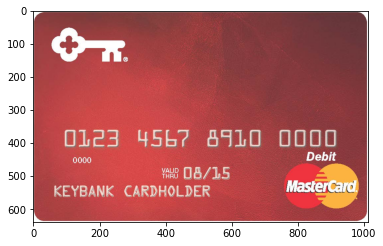

3.jpeg


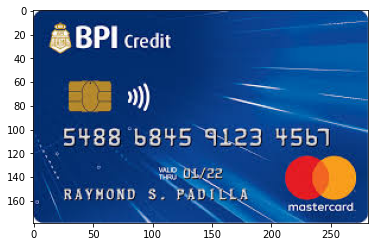

2.jpeg


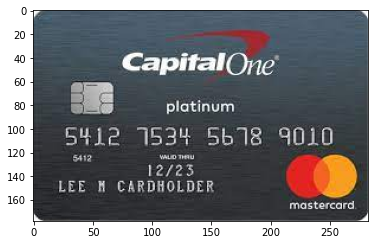

4.jpg


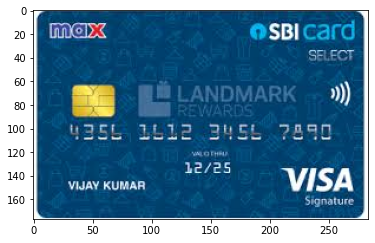

1.jpg


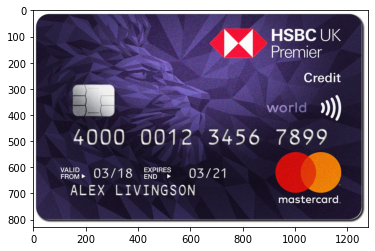

In [17]:
def search(dirname):
    filenames = os.listdir(dirname)
    f_list = []
    for filename in filenames:
        full_filename = os.path.join(dirname, filename)
        f_list.append(full_filename)
        print (filename)
        img = cv2.imread(full_filename, cv2.IMREAD_COLOR)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.show()
    return f_list
f_list = search(path)

## Step2. Google OCR API, keras-ocr, Tesseract로 테스트 진행

#### Google API

In [23]:
def detect_text(path):
    """Detects text in the file."""
    from google.cloud import vision
    import io
    client = vision.ImageAnnotatorClient()

    with io.open(path, 'rb') as image_file:
        content = image_file.read()
        
    image = vision.Image(content=content)

    response = client.text_detection(image=image)
    texts = response.text_annotations
    print('Texts:')

    print('\n"{}"'.format(texts[0].description))

    vertices = (['({},{})'.format(vertex.x, vertex.y)
                 for vertex in texts[0].bounding_poly.vertices])

    print('bounds: {}'.format(','.join(vertices)))

    if response.error.message:
        raise Exception(
            '{}\nFor more info on error messages, check: '
            'https://cloud.google.com/apis/design/errors'.format(
                response.error.message))

In [24]:
import os
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] =  os.getenv('HOME')+'/ocr_python/my_google_api_key.json'

for p_img in f_list:
    detect_text(p_img)

Texts:

"0123 4567 8910 0000
Debit
0000
VALID
THRU
08/15
KEYBANK CARDHOLDER
MasterCard
"
bounds: (65,360),(969,360),(969,561),(65,561)
Texts:

"BPI Credit
5488 6845 9123 4567
OL/22
RAYMOND S. PADILLA
THRU
mastercard.
"
bounds: (26,12),(268,12),(268,168),(26,168)
Texts:

"CapitalOne
platinum
5412 1534 5678 9010
5412
WALID THRU
12/23
LEE M CARDHOLDER
mastercard.
"
bounds: (22,35),(271,35),(271,167),(22,167)
Texts:

"max
OSBI card
SELECT
LANDMARK
REWARDS
435L 1L12 345L ?890
VALO THR
12/25
GI
9 VISA
VIJAY KUMAR
Signature
1790
100
"
bounds: (14,5),(272,5),(272,166),(14,166)
Texts:

"HSBC UK
Premier
Credit
world ))
4000 0012 3456 7899
VALID
FROM
03/18
EXPIRES
END
03/21
ALEX LIVINGSON
mastercard.
"
bounds: (105,72),(1177,72),(1177,738),(105,738)


#### Keras-ocr

In [20]:
import keras_ocr

pipeline = keras_ocr.pipeline.Pipeline()

Looking for /home/aiffel-dj29/.keras-ocr/craft_mlt_25k.h5
Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.
Looking for /home/aiffel-dj29/.keras-ocr/crnn_kurapan.h5


In [26]:
images = ['1.jpg',
          '2.jpeg',
         '3.jpeg','4.jpg','5.jpg'
         ]

for i in images:
    path = os.getenv('HOME')+'/ocr_python/data/'+i
    keras_images = [ keras_ocr.tools.read(path) for i in images]
    prediction_groups = [pipeline.recognize([path]) for i in images]
    print('!.......OCR Complete......!\n')

!.......OCR Complete......!

!.......OCR Complete......!

!.......OCR Complete......!

!.......OCR Complete......!

!.......OCR Complete......!



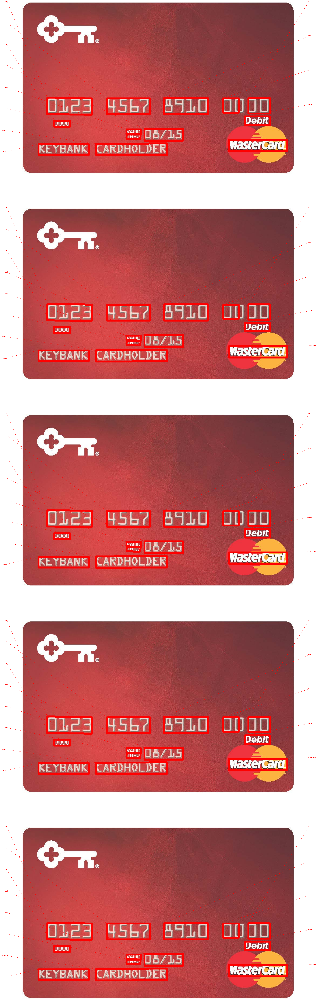

In [27]:
fig, axs = plt.subplots(nrows=len(images), figsize=(180, 180))
for idx, ax in enumerate(axs):
    keras_ocr.tools.drawAnnotations(image=keras_images[idx], 
                                    predictions=prediction_groups[idx][0], ax=ax)

### 테서랙터

In [28]:
import os
import pytesseract
from PIL import Image
from pytesseract import Output
import matplotlib.pyplot as plt

# OCR Engine modes(–oem):
# 0 - Legacy engine only.
# 1 - Neural nets LSTM engine only.
# 2 - Legacy + LSTM engines.
# 3 - Default, based on what is available.

# Page segmentation modes(–psm):
# 0 - Orientation and script detection (OSD) only.
# 1 - Automatic page segmentation with OSD.
# 2 - Automatic page segmentation, but no OSD, or OCR.
# 3 - Fully automatic page segmentation, but no OSD. (Default)
# 4 - Assume a single column of text of variable sizes.
# 5 - Assume a single uniform block of vertically aligned text.
# 6 - Assume a single uniform block of text.
# 7 - Treat the image as a single text line.
# 8 - Treat the image as a single word.
# 9 - Treat the image as a single word in a circle.
# 10 - Treat the image as a single character.
# 11 - Sparse text. Find as much text as possible in no particular order.
# 12 - Sparse text with OSD.
# 13 - Raw line. Treat the image as a single text line, bypassing hacks that are Tesseract-specific.

# 테스트 이미지를 받아서 문자 검출을 시행한 후,
# 검출된 문자 영역을 crop한 이미지로 만들어 그 파일들의 list를 반환하는 함수.
def crop_word_regions(image_path='./images/sample.png', output_path='./output'):
    if not os.path.exists(output_path):
        os.mkdir(output_path)
    custom_oem_psm_config = r'--oem 3 --psm 3'
    image = Image.open(image_path)
    
    # pytesseract의 출력을 사용해서 결과값의 형식을 딕셔너리로 설정.
    # 인식된 Bbox는 left, top, width, height 정보를 가지게 됨. 
    recognized_data = pytesseract.image_to_data(
        image, lang='eng',    # 한국어라면 lang='kor'
        config=custom_oem_psm_config,
        output_type=Output.DICT
    )
    
    top_level = max(recognized_data['level'])
    index = 0
    cropped_image_path_list = []
    for i in range(len(recognized_data['level'])):
        level = recognized_data['level'][i]
    
        if level == top_level:
            left = recognized_data['left'][i]
            top = recognized_data['top'][i]
            width = recognized_data['width'][i]
            height = recognized_data['height'][i]
            
            output_img_path = os.path.join(output_path, f"{str(index).zfill(4)}.png")
            print(output_img_path)
            cropped_image = image.crop((
                left,
                top,
                left+width,
                top+height
            ))
            cropped_image.save(output_img_path)
            cropped_image_path_list.append(output_img_path)
            index += 1
    return cropped_image_path_list

for i in images:
    work_dir = os.getenv('HOME')+'/aiffel/ocr_python/data/'
    img_file_path = work_dir + i
    cropped_image_path_list = crop_word_regions(img_file_path, work_dir)
    print('!.......OCR Complete......!\n')

FileNotFoundError: [Errno 2] No such file or directory: '/home/aiffel-dj29/aiffel/ocr_python/data/'